# Installing and importing dependencies 📚

In [ ]:
!pip install ultralytics
!pip install -U ipywidgets
!pip install ffmpeg-python

In [2]:
from ultralytics import YOLO
import glob
import os
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import math
import yaml
import torch
import cv2
import random
from IPython.display import HTML, display, Image
from base64 import b64encode

In [3]:
np.random.seed(12345)

In [4]:
!wandb disabled

W&B disabled.


In [5]:
dataset_root = '/kaggle/input/construction-site-safety-image-dataset-roboflow/css-data'

# EDA 📊

<span style="font-size:18px;"> In this section we will explore that dataset, performing EDA (Exploratory Data Analysis).

In [6]:
class_map = {0: 'Hardhat', 1: 'Mask', 2: 'NO-Hardhat', 3: 'NO-Mask', 4: 'NO-Safety Vest', 5: 'Person', 6: 'Safety Cone', 7: 'Safety Vest', 8: 'machinery', 9: 'vehicle'}
classes = ['Hardhat', 'Mask', 'NO-Hardhat', 'NO-Mask', 'NO-Safety Vest', 'Person', 'Safety Cone', 'Safety Vest', 'machinery', 'vehicle']

In [7]:
for subset_folder in ['train', 'valid', 'test']:
    subset_images = glob.glob(os.path.join(dataset_root, subset_folder, 'images','*.jpg'))
    print(f"Number of {subset_folder} images:", len(subset_images))

Number of train images: 2605
Number of valid images: 114
Number of test images: 82


<span style="font-size:18px;"> Let's visualize a few images from the training set.

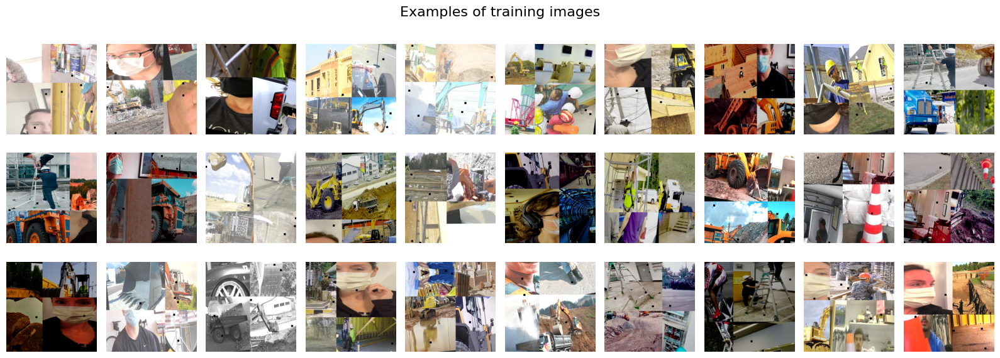

In [8]:
test_imgs_with_pred = glob.glob(os.path.join(dataset_root, 'train', 'images','*.jpg'))

fig, axes = plt.subplots(3, 10, figsize=(16,6))
fig.suptitle('Examples of training images', fontsize=16)


# Randomly select 15 images
selected_images = random.sample(test_imgs_with_pred, 30)

for i, ax in enumerate(axes.flatten()):
    # Read the image
    image = cv2.imread(selected_images[i])

    # Convert BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image
    ax.imshow(image)
    ax.axis("off")
    #ax.set_title(f"Image {i+1}")

# Adjust layout
plt.tight_layout()
plt.show()

<span style="font-size:18px;">  We can notice that there are some tiny black rectangles on most of the training images and this is because one of the augmentation techniques used for this dataset is random crop between 0 and 20% for each image. 

In [9]:
classes_dict = {}
for subset_folder in ['train', 'valid', 'test']:
    label_folder = glob.glob(os.path.join(dataset_root, subset_folder, 'labels','*.txt'))
    cl = []
    for anno_file in label_folder:
        with open(anno_file) as f:
            lines = [line.strip() for line in open(anno_file, 'r')]
            cl.extend([line[0][0] for line in lines])
    cl_count = {c: cl.count(c) for c in cl}
    classes_dict[subset_folder] = cl_count


## Bar charts

<span style="font-size:18px;">  Every bar chart represents the number of instances for each class within the train, validation and test sets. We can see that 'Person' class is the major class, and 'Mask' class is the minority class with the fewest instances in all sets. <span>

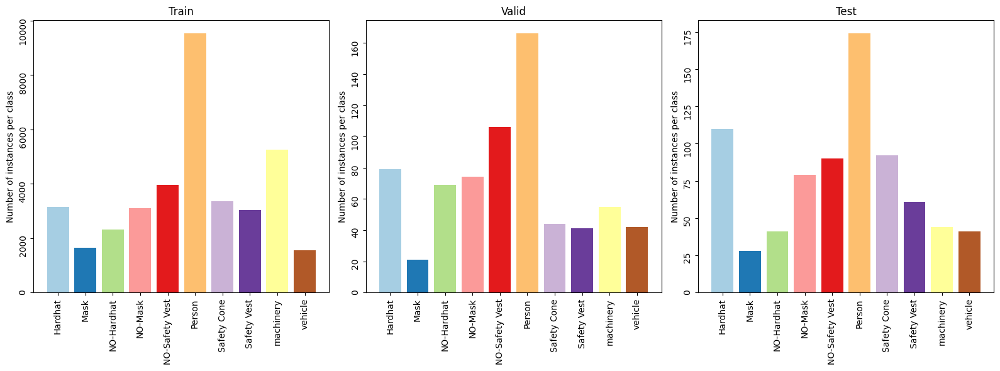

In [10]:
fig, axes = plt.subplots(1, len(classes_dict), figsize=(16, 6))

# Create a colormap
cmap = plt.get_cmap('Paired')

# Generate colors based on the colormap for each class
colors = cmap(np.linspace(0, 1, len(classes)))

# Iterate through each class and create a bar chart in a separate subplot
for i, (class_name, attributes) in enumerate(classes_dict.items()):
    sorted_attribute_names = sorted(list(attributes.keys()))
    sorted_measurments = [attributes[c] for c in sorted_attribute_names]
    # Set up x values for each attribute
    x = np.arange(len(sorted_attribute_names))

    # Plot the bar chart in the ith subplot
    axes[i].bar(x, sorted_measurments, tick_label=[class_map[int(item)] for item in sorted_attribute_names], color=colors)
    axes[i].tick_params(rotation=90)
    axes[i].set_title(f'{class_name.capitalize()}')
    axes[i].set_ylabel('Number of instances per class')

plt.tight_layout()
plt.show()

## Pie charts 

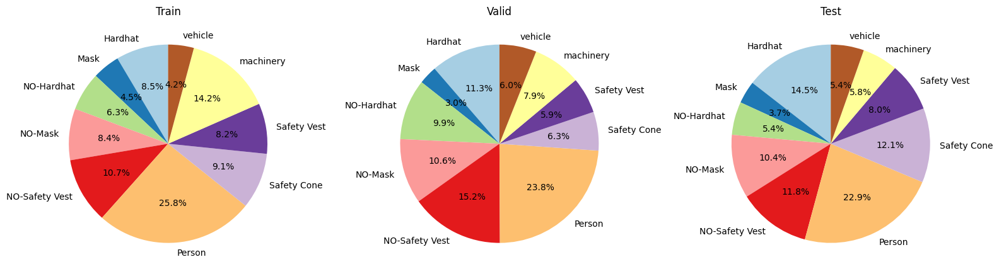

In [11]:
fig, axes = plt.subplots(1, len(classes_dict), figsize=(16, 6))

# Generate colors based on the colormap
colors = cmap(np.linspace(0, 1, len(classes)))

# Iterate through each class and create a pie chart in a separate subplot
for i, (class_name, attributes) in enumerate(classes_dict.items()):
    sorted_attribute_names = sorted(list(attributes.keys()))
    sorted_measurments = [attributes[c] for c in sorted_attribute_names]

    axes[i].pie(sorted_measurments, labels=[class_map[int(item)] for item in sorted_attribute_names], autopct='%1.1f%%', startangle=90, colors=colors)
    axes[i].set_title(f'{class_name.capitalize()}')

plt.tight_layout()
plt.show()

# Model training (Yolov8) ⏳

<span style="font-size:18px;"> For this project, we will use Yolov8, nano version, from Ultralytics. The model is trained for 40 epochs and batch size 32. </span>

In [12]:
model = YOLO('yolov8n.pt')

<span style="font-size:18px;"> In order to train the Yolov8 model we need a dataset yaml. config file that defines the dataset root directory path, the paths to train / val / test image directories and dictionary containing the dataset class names.

In [13]:
yolo_yaml = {'path': dataset_root,
             'train': os.path.join(dataset_root, 'train/images'),  
             'val': os.path.join(dataset_root, 'valid/images'),
             'test': os.path.join(dataset_root, 'test/images'), 

            # Classes 
            'names' : {
              0: 'Hardhat',
              1: 'Mask',
              2: 'NO-Hardhat',
              3: 'NO-Mask',
              4: 'NO-Safety Vest',
              5: 'Person',
              6: 'Safety Cone',
              7: 'Safety Vest',
              8: 'machinery',
              9: 'vehicle'}
            }
            

with open(os.path.join('/kaggle/working/', 'data.yaml'), 'w+') as file:
    yaml.dump(yolo_yaml, file)

In [14]:
model.train(data='/kaggle/working/data.yaml', epochs=40, batch=32, imgsz=640, name='Initial training with yolov8')

<span style="font-size:18px;">  Let's visualize the results on the training as well as the validation datasets.

<span style="font-size:18px;"> Looking at the plots, we can observe that the loss is steadily decreasing, while the metrics are increasing. We could further enhance the model's performance by training for more epochs or using a larger version of the Yolo model. Nevertheless, the current results already appear quite satisfactory for the purpose of this notebook.

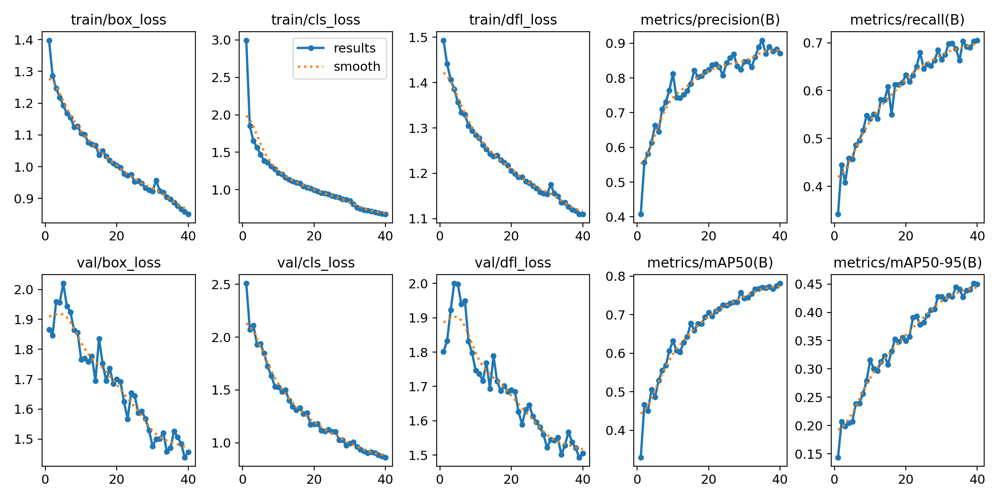

In [15]:
Image(filename=f'/kaggle/working/runs/detect/Initial training with yolov810/results.png', width=900)

# Inference on test data 😎

<span style="font-size:18px;">  Now it is time to run inference on test images. We will pick randomly 15 images from the test dataset and visualize them to evaluate the results.

In [16]:
trained_detection_model = YOLO('/kaggle/working/runs/detect/Initial training with yolov810/weights/best.pt')

In [17]:
detection_results = trained_detection_model.predict(source=os.path.join(dataset_root, 'test/images'), save=True)

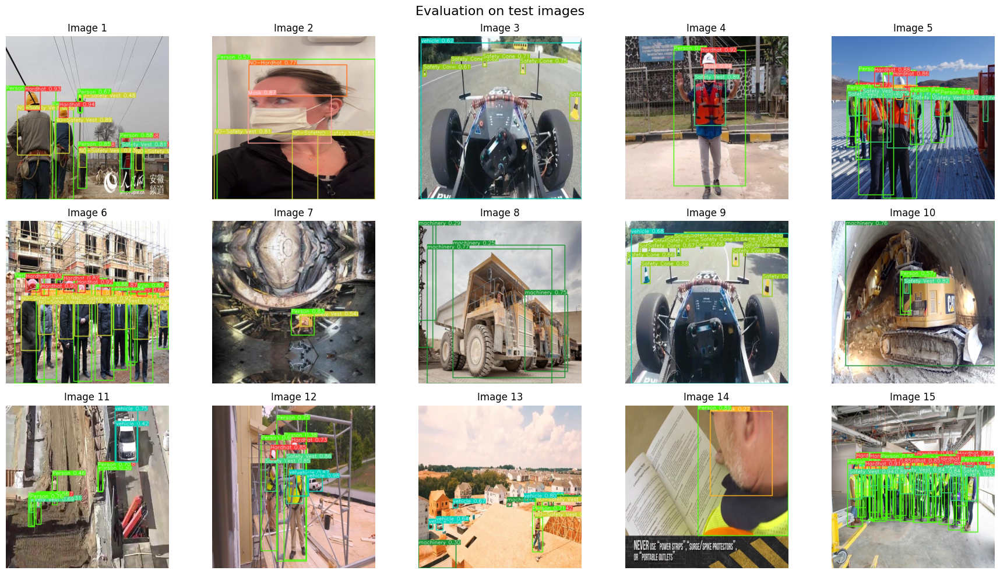

In [18]:
det_res_out_path = '/kaggle/working/runs/detect/predict'

test_imgs_with_pred = glob.glob(os.path.join(det_res_out_path,'*.jpg'))

fig, axes = plt.subplots(3, 5, figsize=(18, 10))
fig.suptitle('Evaluation on test images', fontsize=16)

# Randomly select 15 images
selected_images = random.sample(test_imgs_with_pred, 15)

for i, ax in enumerate(axes.flatten()):
    image = cv2.imread(selected_images[i])
    # Convert BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f"Image {i+1}")

plt.tight_layout()
plt.show()

<span style="font-size:18px;"> After evaluating the object detector, it's observed that the bounding boxes are generally well-aligned with detected objects and in most cases the bounding boxes exhibit high confidence scores, indicating robust detections. However, there are a few instances with lower confidence scores, suggesting potential uncertainty. In conclusion, the object detector performs reasonably well on the test set. Further fine-tuning or experimenting with different models could potentially improve performance in challenging examples.

# Object tracking 🔍

<span style="font-size:18px;"> Yolov8 also offers the option for object tracking, with two implemented algorithms, BoT-SORT and ByteTrack. In this notebook we will use ByteTrack.
    We will run tracking on a video provided by this dataset.

In [19]:
save_dir = '/kaggle/working/runs/tracking'

In [20]:
tracking_results = trained_detection_model.track(source="/kaggle/input/construction-site-safety-image-dataset-roboflow/source_files/source_files/JapanPPE.mp4", show=True, save=True, name=save_dir, imgsz=640, tracker="bytetrack.yaml")  # Tracking with ByteTrack tracker

<span style="font-size:18px;"> The output video is in .avi extension but we can convert it to .mp4 for easier visualization inside the notebook.

In [21]:
!ffmpeg -i /kaggle/working/runs/tracking/JapanPPE.avi /kaggle/working/runs/tracking/JapanPPE.mp4

<span style="font-size:18px;"> The ByteTrack algorithm demonstrates a decent performance, consistently following the objects across frames in most cases. However, it seems to fail to follow occluded objects. Additionally, there are instances where the same object is not detected in some frames, introducing sporadic gaps in the tracking. These limitations can impact the algorithm's ability to maintain consistent tracking results, especially in complex scenes with overlapping or occluded objects. Exploring improvements in handling occlusions and addressing occasional detection gaps could further enhance the algorithm's robustness in challenging tracking scenarios.

In [22]:
def play_video(filename):
    video_data = open(filename, 'rb').read()
    video_src = 'data:video/mp4;base64,' + b64encode(video_data).decode()

    html = f'<video width=1000 controls autoplay loop><source src="{video_src}" type="video/mp4"></video>'
    return HTML(html)

play_video('/kaggle/working/runs/tracking/JapanPPE.mp4')